In [1]:
print("Install geoviews and pyviz...")
print("This can be very long, don't worry")
# Installing geoviews is very annoying (in colab it is, not tried on local machine)
# See those responses from stackoverflow : https://stackoverflow.com/a/72788088

# Uninstall existing shapely
# We will re-install shapely in the next step by ignoring the binary
# wheels to make it compatible with other modules that depend on 
# GEOS, such as Cartopy (used here).
!pip uninstall --yes shapely

# To install cartopy in Colab using pip, we need to install the library 
# dependencies first.
!apt-get install -qq libgdal-dev libgeos-dev
!pip install shapely --no-binary shapely
!pip install cartopy==0.18.0

#Install geoviews
!pip install geoviews geopandas
# After that, shapely will trigger a lot of deprecation warnings, do not worry about
import warnings
warnings.filterwarnings('ignore', module='shapely')

Install geoviews and pyviz...
This can be very long, don't worry
Found existing installation: Shapely 1.8.4
Uninstalling Shapely-1.8.4:
  Successfully uninstalled Shapely-1.8.4
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 200 kB 9.1 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
  Created wheel for shapely: filename=Shapely-1.8.5.post1-cp37-cp37m-linux_x86_64.whl size=669779 sha256=bc31ff6a3b8dc0c071952d17d1728e0fc84a08d34abb29a57b27358ac435e060
  Stored in directory: /root/.cache/pip/wheels/a3/07/7c/cc50e8ecc795963726466b22ecd395ee1e2a28da87a4cdeb56
Successfully built shapely
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 14.4 MB 7.4 MB/s 
     |███████████████████████████████

In [2]:
# This is the id of the dataset stored in a drive 
!gdown 10IV7SljltirCzjssfbMTxyVvZ3_EB3rB --output dataset.csv.gz
!gzip -dkv dataset.csv.gz -f

Downloading...
From: https://drive.google.com/uc?id=10IV7SljltirCzjssfbMTxyVvZ3_EB3rB
To: /content/dataset.csv.gz
100% 281M/281M [00:03<00:00, 84.2MB/s]
dataset.csv.gz:	 66.2% -- replaced with dataset.csv


In [3]:
from pathlib import Path
import pandas as pd
import numpy as np
import os
import sys
import subprocess
from tqdm import tqdm
from typing import Union, Any, List, Iterable

DATASET_PATH = Path("./dataset.csv")

def count_nb_lines(path: Union[str, Path]) -> int:
    command = (f"wc -l {path.as_posix()}" if isinstance(path, Path)
        else f"wc -l {path}"
    ) 
    return int(subprocess.check_output(command, shell=True).split()[0]) - 1

def load_csv(path) -> pd.DataFrame:
    nb_lines = count_nb_lines(path)
    # Create an example dataframe, with all columns
    df = pd.read_csv(path, nrows=0, index_col=[0])
    dataframes = [df[:0]]
    chunk_size = 4096
    with tqdm(total=nb_lines, desc="Load csv chunks") as pbar:
        for i, chunk in enumerate(pd.read_csv(path, chunksize=chunk_size, low_memory=False, index_col=[0])):
            # df = pd.concat([df, chunk], ignore_index=True)
            dataframes.append(chunk)
            pbar.update(chunk_size)
    print("Concat chunks")
    return pd.concat(dataframes)

In [4]:
dataset = load_csv(DATASET_PATH)
dataset

Load csv chunks: 4800512it [00:40, 117547.71it/s]                             


Concat chunks


,id_mutation,date_mutation,numero_disposition,nature_mutation,valeur_fonciere,adresse_numero,adresse_suffixe,adresse_nom_voie,adresse_code_voie,code_postal,...,code_type_local,type_local,surface_reelle_bati,nombre_pieces_principales,surface_terrain,longitude,latitude,date_mutation_annee,date_mutation_mois,date_mutation_jour
3846451,2017-1016305,2017-01-01,1,Vente,149200,124.0,NaN,AV DE GENEVE - ANNECY,1090,74000,...,2,Appartement,56.0,2,0.0,6.124644,45.923373,2017,1,1
4374565,2017-414602,2017-01-01,1,Vente,112000,40.0,NaN,RUE FONTENELLE,0409,33140,...,2,Appartement,47.0,2,0.0,-0.576723,44.771351,2017,1,1
4758043,2017-944970,2017-01-01,1,Vente,140000,17.0,NaN,RUE PAUL VERLAINE,3100,69100,...,2,Appartement,42.0,2,0.0,4.880406,45.768108,2017,1,1
4086169,2017-1331938,2017-01-01,1,Vente,270000,7.0,NaN,RUE EMILE GOEURY,0970,93220,...,1,Maison,94.0,4,451.0,2.544544,48.879254,2017,1,1
4526338,2017-625328,2017-01-02,1,Vente,204750,2.0,NaN,VEN DU SERPENTIN,0603,44119,...,1,Maison,90.0,4,0.0,-1.629645,47.337118,2017,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
633959,2021-704333,2021-12-31,2,Vente,587703,5.0,NaN,RUE WATTEAU RGE LEFEBVRE,2881,59150,...,1,Maison,50.0,3,25.0,NaN,NaN,2021,12,31
830121,2021-964658,2021-12-31,1,Vente,335000,16.0,NaN,AV DU GRAND CANAL,0394,78450,...,2,Appartement,60.0,3,0.0,1.992803,48.834463,2021,12,31
830161,2021-964706,2021-12-31,1,Vente,5228800,3.0,NaN,RTE DE GRANDCHAMP,0090,78113,...,1,Maison,527.0,12,11300.0,1.617997,48.705250,2021,12,31
445017,2021-442506,2021-12-31,1,Vente,258000,17.0,NaN,ALL PIERRE SIMON DE LAPLACE,0869,37400,...,1,Maison,84.0,4,270.0,0.972299,47.404027,2021,12,31


## Visualisations haut niveau

### Répartition par surface (global, puis par région)

### Présence des données par date

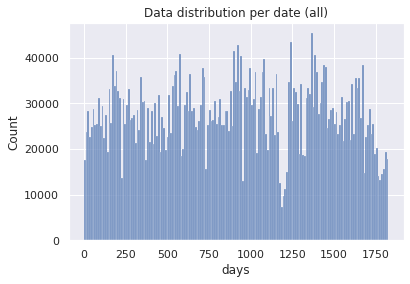

In [5]:
import datetime as dt
import seaborn as sns
import matplotlib.pyplot as plt

def to_datetime(date_str: str) -> dt.datetime:
    return dt.datetime.strptime(date_str, '%Y-%m-%d').date()

def display_data_per_date(df: pd.DataFrame, title: str):
    date_series = df["date_mutation"].apply(to_datetime)

    min_date = date_series.min()

    date_df = pd.DataFrame({"date":date_series})
    date_df["days"] = date_df["date"] - min_date
    date_df["days"] = date_df["days"].apply(lambda d: d.days)

    sns.set()
    plt.title(title)
    sns.histplot(date_df["days"])
    plt.show()

display_data_per_date(dataset, "Data distribution per date (all)")

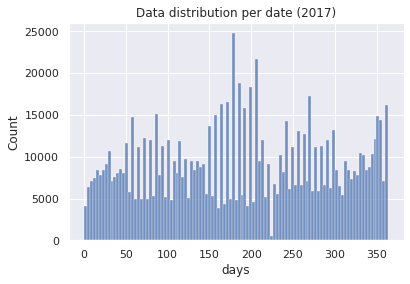

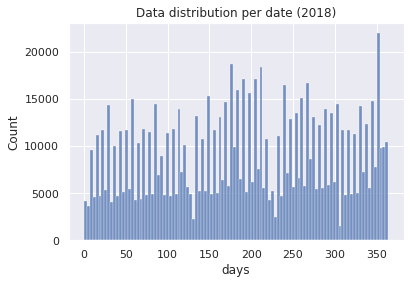

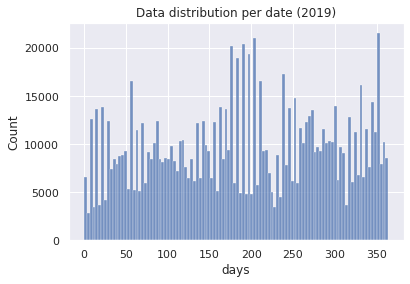

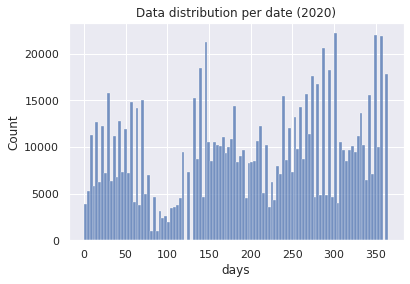

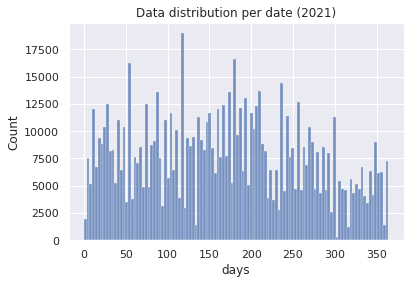

In [6]:
# Do the same for each year
for year, group in dataset.groupby("date_mutation_annee"):
    display_data_per_date(group, f"Data distribution per date ({year})")

On voit l'impact du COVID dans les statistiques (cela pourrait impacter négativement les performances du modèle)

### Présence des prix par Région / Département

#### Par région

In [7]:
# We only have departements : link the departement to the region with this dict
region_by_dep = {'01': 'Auvergne-Rhône-Alpes','02': 'Hauts-de-France','03': 'Auvergne-Rhône-Alpes','04': "Provence-Alpes-Côte d'Azur",'05': "Provence-Alpes-Côte d'Azur",'06': "Provence-Alpes-Côte d'Azur",'07': 'Auvergne-Rhône-Alpes','08': 'Grand Est','09': 'Occitanie','10': 'Grand Est','11': 'Occitanie','12': 'Occitanie','13': "Provence-Alpes-Côte d'Azur",'14': 'Normandie','15': 'Auvergne-Rhône-Alpes','16': 'Nouvelle-Aquitaine','17': 'Nouvelle-Aquitaine','18': 'Centre-Val de Loire','19': 'Nouvelle-Aquitaine','21': 'Bourgogne-Franche-Comté','22': 'Bretagne','23': 'Nouvelle-Aquitaine','24': 'Nouvelle-Aquitaine','25': 'Bourgogne-Franche-Comté','26': 'Auvergne-Rhône-Alpes','27': 'Normandie','28': 'Centre-Val de Loire','29': 'Bretagne','2A': 'Corse','2B': 'Corse','30': 'Occitanie','31': 'Occitanie','32': 'Occitanie','33': 'Nouvelle-Aquitaine','34': 'Occitanie','35': 'Bretagne','36': 'Centre-Val de Loire','37': 'Centre-Val de Loire','38': 'Auvergne-Rhône-Alpes','39': 'Bourgogne-Franche-Comté','40': 'Nouvelle-Aquitaine','41': 'Centre-Val de Loire','42': 'Auvergne-Rhône-Alpes','43': 'Auvergne-Rhône-Alpes','44': 'Pays de la Loire','45': 'Centre-Val de Loire','46': 'Occitanie','47': 'Nouvelle-Aquitaine','48': 'Occitanie','49': 'Pays de la Loire','50': 'Normandie','51': 'Grand Est','52': 'Grand Est','53': 'Pays de la Loire','54': 'Grand Est','55': 'Grand Est','56': 'Bretagne','57': 'Grand Est','58': 'Bourgogne-Franche-Comté','59': 'Hauts-de-France','60': 'Hauts-de-France','61': 'Normandie','62': 'Hauts-de-France','63': 'Auvergne-Rhône-Alpes','64': 'Nouvelle-Aquitaine','65': 'Occitanie','66': 'Occitanie','67': 'Grand Est','68': 'Grand Est','69': 'Auvergne-Rhône-Alpes','70': 'Bourgogne-Franche-Comté','71': 'Bourgogne-Franche-Comté','72': 'Pays de la Loire','73': 'Auvergne-Rhône-Alpes','74': 'Auvergne-Rhône-Alpes','75': 'Île-de-France','76': 'Normandie','77': 'Île-de-France','78': 'Île-de-France','79': 'Nouvelle-Aquitaine','80': 'Hauts-de-France','81': 'Occitanie','82': 'Occitanie','83': "Provence-Alpes-Côte d'Azur",'84': "Provence-Alpes-Côte d'Azur",'85': 'Pays de la Loire','86': 'Nouvelle-Aquitaine','87': 'Nouvelle-Aquitaine','88': 'Grand Est','89': 'Bourgogne-Franche-Comté','90': 'Bourgogne-Franche-Comté','91': 'Île-de-France','92': 'Île-de-France','93': 'Île-de-France','94': 'Île-de-France','95': 'Île-de-France','971': 'Guadeloupe','972': 'Martinique','973': 'Guyane','974': 'La Réunion','976': 'Mayotte'}
# We have some departements with "4" instead of "04" for example
dataset["code_departement"] = dataset["code_departement"].astype(str).apply(lambda c: f"{int(c):02d}" if c.isnumeric() else c)
dataset["region"] = dataset["code_departement"].apply(lambda d: region_by_dep[d])

# Now, we count the number of entries per region
entries_per_region = {region: len(group) for region, group in dataset.groupby("region")}

In [8]:
for region in entries_per_region.keys():
    print(f"Entries for region \"{region}\" : {len(dataset[dataset['region'] == region])}")

Entries for region "Auvergne-Rhône-Alpes" : 597730
Entries for region "Bourgogne-Franche-Comté" : 199394
Entries for region "Bretagne" : 283233
Entries for region "Centre-Val de Loire" : 190504
Entries for region "Corse" : 19550
Entries for region "Grand Est" : 176377
Entries for region "Guadeloupe" : 8351
Entries for region "Guyane" : 4124
Entries for region "Hauts-de-France" : 403047
Entries for region "La Réunion" : 24356
Entries for region "Martinique" : 8950
Entries for region "Normandie" : 242892
Entries for region "Nouvelle-Aquitaine" : 512793
Entries for region "Occitanie" : 495534
Entries for region "Pays de la Loire" : 323919
Entries for region "Provence-Alpes-Côte d'Azur" : 447863
Entries for region "Île-de-France" : 859278


On va représenter les données sur la carte de france afin d'être plus représentatif

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
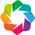

/usr/local/lib/python3.7/dist-packages/cartopy/io/__init__.py:260: DownloadWarning: Downloading: https://naciscdn.org/naturalearth/110m/physical/ne_110m_ocean.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check th

:Feature   [Longitude,Latitude]

In [9]:
import geoviews as gv
import geoviews.feature as gf

gv.extension('bokeh', 'matplotlib')
gf.ocean

On va récupérer les données de la carte de france sur le repository france-geojson :
* Régions : https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/regions-version-simplifiee.geojson
* Départements : https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements-version-simplifiee.geojson

In [10]:
import requests
def download_file(url: str, dest: Union[str, Path]):
    response = requests.get(url)
    with open(dest, "wb") as file:
        file.write(response.content)

In [11]:
regions_path = Path("regions.geojson")
departements_path = Path("departements.geojson")
download_file("https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/regions-version-simplifiee.geojson", regions_path)
download_file("https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements-version-simplifiee.geojson", departements_path)

#### Tuto pour utiliser goeviews / geopandas

In [12]:
import geopandas as gpd
regions_df = gpd.read_file(regions_path)
regions_df

,code,nom,geometry
0,11,Île-de-France,"POLYGON ((2.59052 49.07965, 2.63327 49.10838, ..."
1,24,Centre-Val de Loire,"POLYGON ((2.87463 47.52042, 2.88845 47.50943, ..."
2,27,Bourgogne-Franche-Comté,"POLYGON ((3.62942 46.74946, 3.57569 46.74952, ..."
3,28,Normandie,"POLYGON ((-1.11962 49.35557, -1.07822 49.38849..."
4,32,Hauts-de-France,"POLYGON ((4.04797 49.40564, 4.03991 49.39740, ..."
5,44,Grand Est,"POLYGON ((4.23316 49.95775, 4.30810 49.96952, ..."
6,52,Pays de la Loire,"MULTIPOLYGON (((-2.45849 47.44812, -2.45343 47..."
7,53,Bretagne,"MULTIPOLYGON (((-3.65914 48.65921, -3.63649 48..."
8,75,Nouvelle-Aquitaine,"MULTIPOLYGON (((1.41519 46.34722, 1.43538 46.3..."
9,76,Occitanie,"MULTIPOLYGON (((1.78613 42.57362, 1.77316 42.5..."


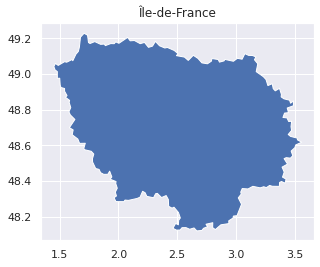

In [13]:
ax = regions_df[regions_df["nom"] == "Île-de-France"].geometry.plot()
ax.set_title("Île-de-France")
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
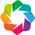

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part 

:Polygons   [Longitude,Latitude]   (nom,value)

In [14]:
import geoviews as gv
from geoviews import dim
# The "gv.extension('bokeh')" must be called in each cell where we have to display a geoviews plot
gv.extension('bokeh')
regions_df['value'] = np.random.randint(1, 10, regions_df.shape[0])
gv.Polygons(regions_df, vdims=['nom','value']).options(
    width=600, height=600, toolbar='above', color=dim('value'),
    colorbar=True, tools=['hover'], aspect='equal'
)

#### Répartition des entrées en fonction de la région

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
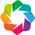

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part 

:Polygons   [Longitude,Latitude]   (nom,value)

In [15]:
regions_df['value'] = regions_df["nom"].apply(entries_per_region.get)
gv.extension('bokeh')
gv.Polygons(regions_df, vdims=['nom','value']).options(
    width=600, height=600, toolbar='above', color=dim('value'),
    colorbar=True, tools=['hover'], aspect='equal',
    title="Data repartition per region"
)

#### Répartition des entrées par département

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
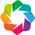

/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(multi_line_string) > 1:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:297: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for line in multi_line_string:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:364: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  if len(p_mline) > 0:
/usr/local/lib/python3.7/dist-packages/cartopy/crs.py:245: ShapelyDeprecationWarning: __len__ for multi-part 

:Polygons   [Longitude,Latitude]   (code,value)

In [16]:
def display_entries_per_departement():
    departements_df = gpd.read_file("https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements-version-simplifiee.geojson")
    dataset["code_departement"] = dataset["code_departement"].astype(str).apply(lambda c: f"{int(c):02d}" if c.isnumeric() else c)
    entries_per_departement = {dpt: len(group) for dpt, group in dataset.groupby("code_departement")}
    
    departements_df['value'] = departements_df["code"].apply(entries_per_departement.get)
    gv.extension('bokeh')
    return gv.Polygons(departements_df, vdims=['code','value']).options(
        width=600, height=600, toolbar='above', color=dim('value'),
        colorbar=True, tools=['hover'], aspect='equal',
        title="Data repartition per departement"
    )

display_entries_per_departement()

DONC : on a pas d'entrées pour les départements :
* Moselle 
* Bas-Rhin
* Haut-Rhin

### Répartition des prix 

## Répartition globale et par année

On aimerait voir que certains mois "coûtent moins chers" que d'autres (par exemple, août)

#### Globale

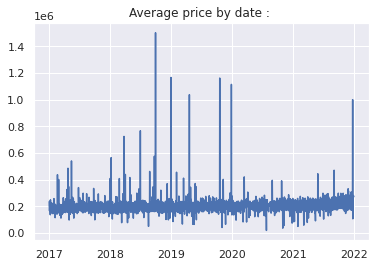

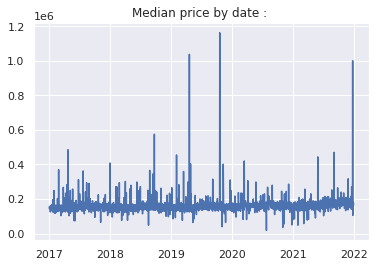

In [17]:
"""
Steps : 
    - group by date
    - for each date, find the average, median price
    - plot it
"""

def to_datetime(date_str: str) -> dt.datetime:
    return dt.datetime.strptime(date_str, '%Y-%m-%d').date()

def display_price_date_repartition(dataset: pd.DataFrame, title: str):
    df = dataset.filter(["date_mutation", "valeur_fonciere"], axis=1)
    df["date_mutation"] = df["date_mutation"].apply(to_datetime)
    df["valeur_fonciere"] = df["valeur_fonciere"].astype(float)
    
    groups = df.groupby("date_mutation")
    average_per_date = {id: group.mean(numeric_only=True).values[0] for id, group in groups}
    median_per_date = {id: group.median(numeric_only=True).values[0] for id, group in groups}
    
    sns.set()
    plt.title(f"Average price by date : {title}")
    plt.plot(list(average_per_date.keys()), list(average_per_date.values()))
    plt.show()

    plt.title(f"Median price by date : {title}")
    plt.plot(list(median_per_date.keys()), list(median_per_date.values()))
    plt.show()

display_price_date_repartition(dataset, "")

In [18]:
dataset["date_mutation"]

3846451    2017-01-01
4374565    2017-01-01
4758043    2017-01-01
4086169    2017-01-01
4526338    2017-01-02
              ...    
633959     2021-12-31
830121     2021-12-31
830161     2021-12-31
445017     2021-12-31
472154     2021-12-31
Name: date_mutation, Length: 4797895, dtype: object

### Répartition par région

#### Tout ce qui est dispo

In [19]:
def rep_price_by_region():
    for region, group in dataset.groupby("region"):
        print(f"==== {region} ====")
        display_price_date_repartition(group, region)

==== Auvergne-Rhône-Alpes ====


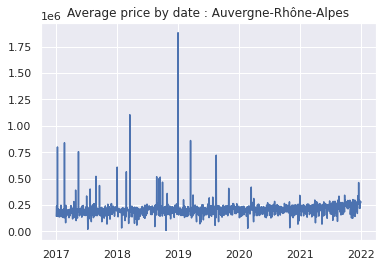

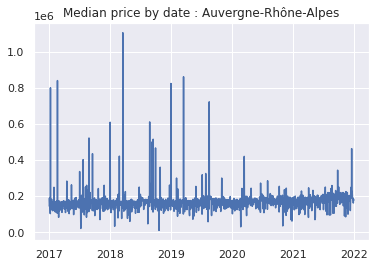

==== Bourgogne-Franche-Comté ====


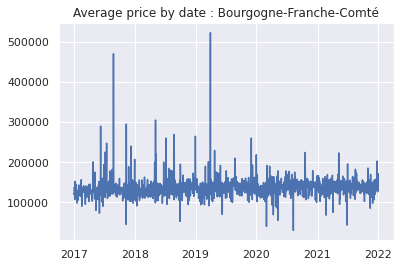

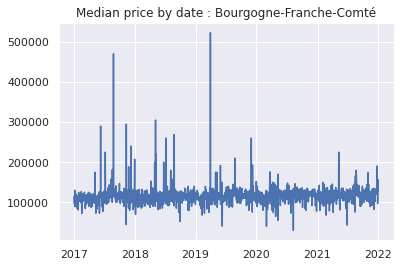

==== Bretagne ====


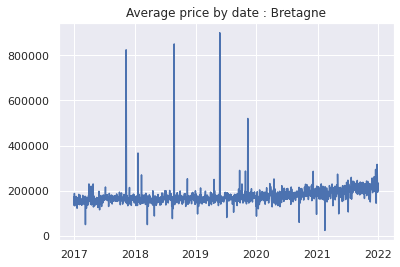

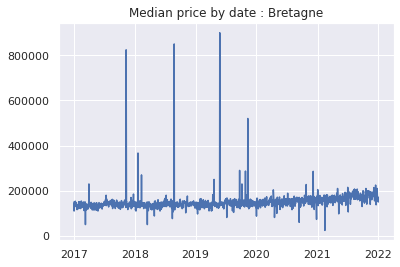

==== Centre-Val de Loire ====


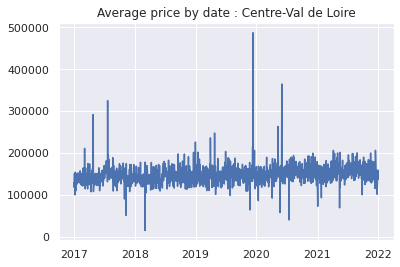

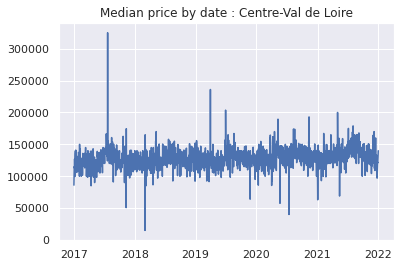

==== Corse ====


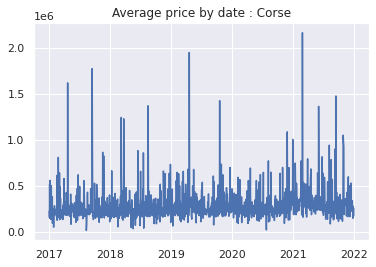

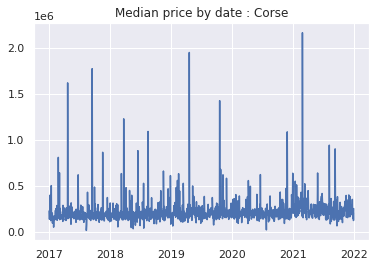

==== Grand Est ====


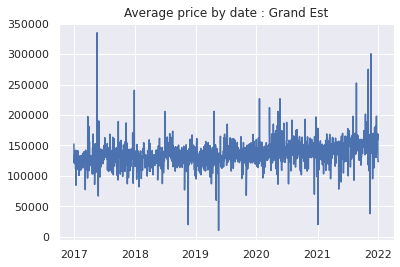

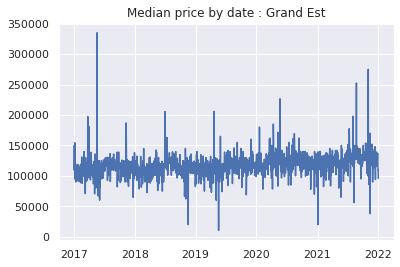

==== Guadeloupe ====


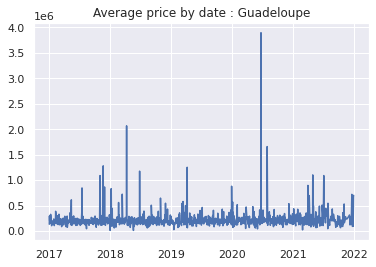

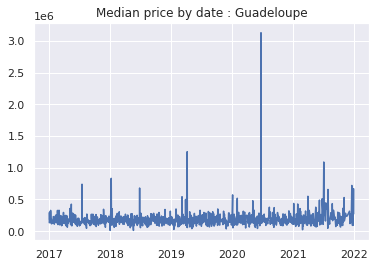

==== Guyane ====


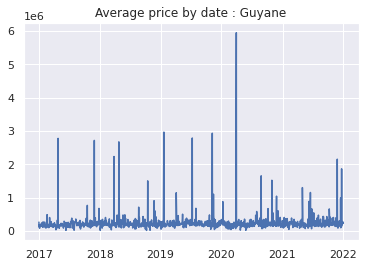

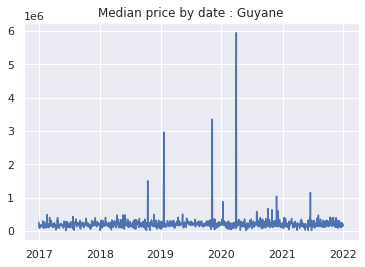

==== Hauts-de-France ====


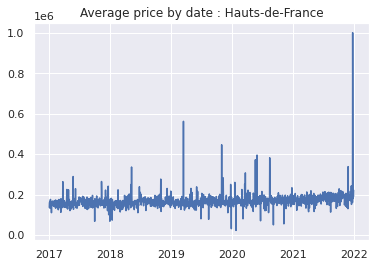

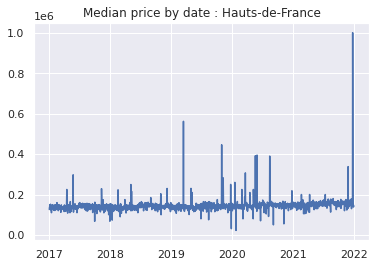

==== La Réunion ====


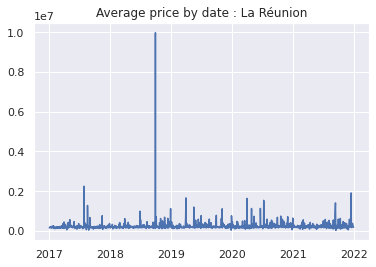

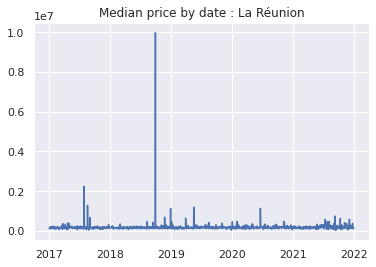

==== Martinique ====


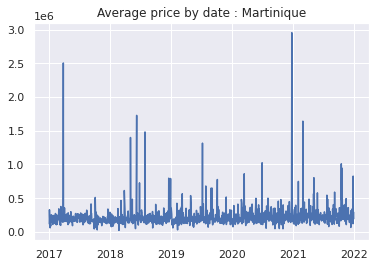

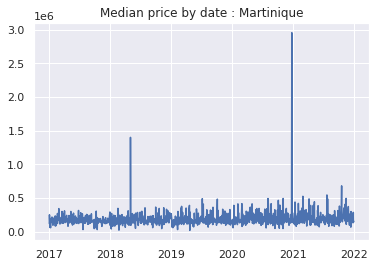

==== Normandie ====


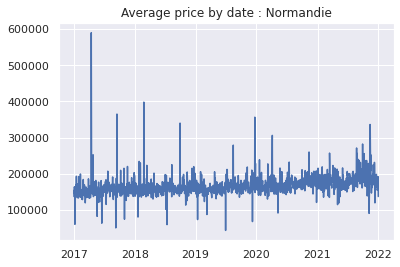

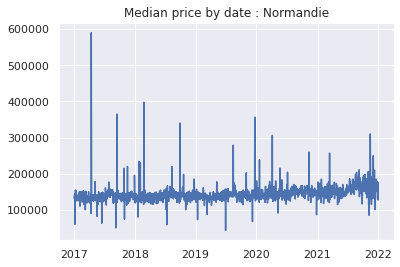

==== Nouvelle-Aquitaine ====


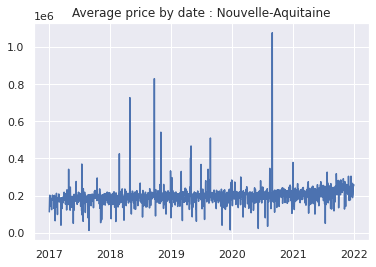

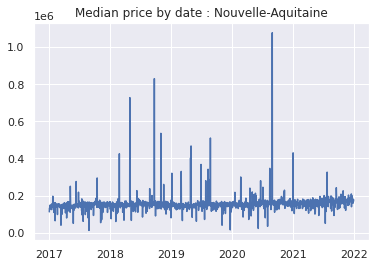

==== Occitanie ====


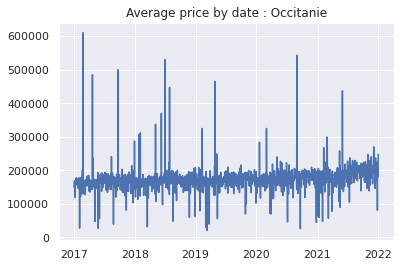

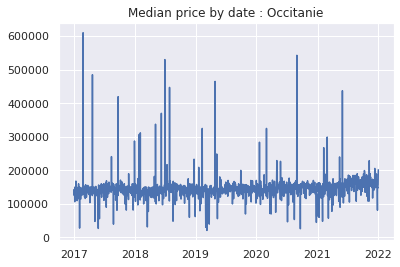

==== Pays de la Loire ====


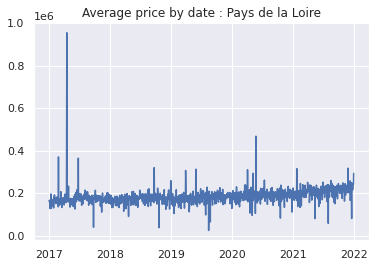

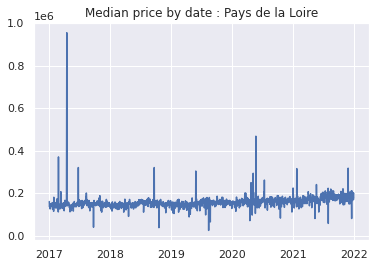

==== Provence-Alpes-Côte d'Azur ====


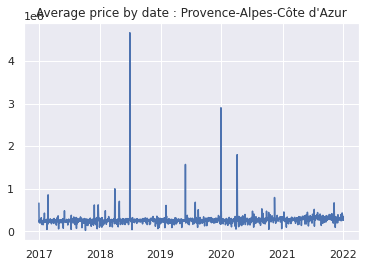

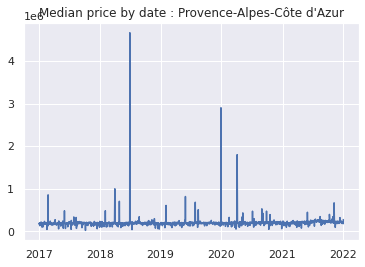

==== Île-de-France ====


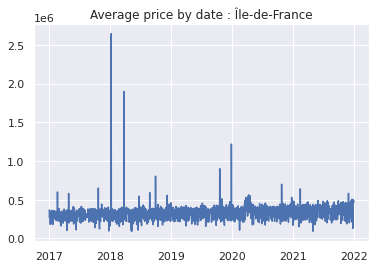

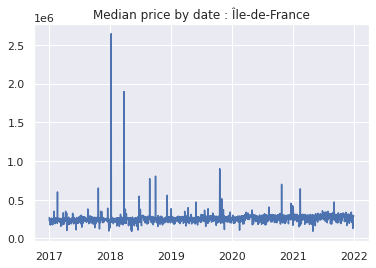

In [20]:
rep_price_by_region()

#### En supprimant les 10% des biens les plus chers

==== Auvergne-Rhône-Alpes ====


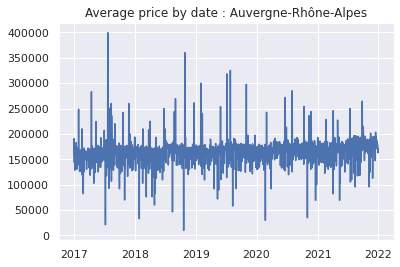

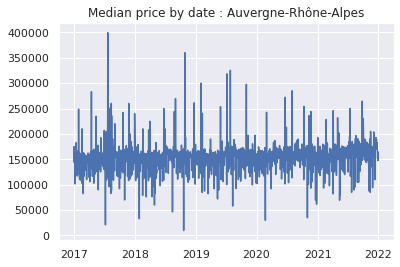

==== Bourgogne-Franche-Comté ====


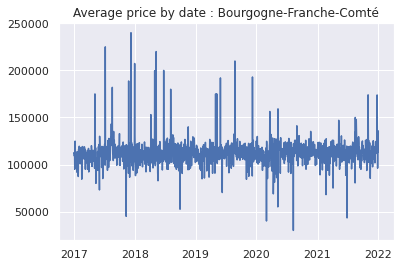

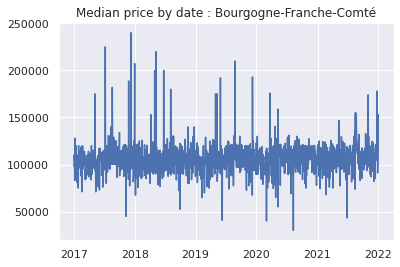

==== Bretagne ====


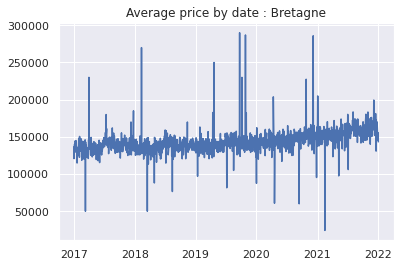

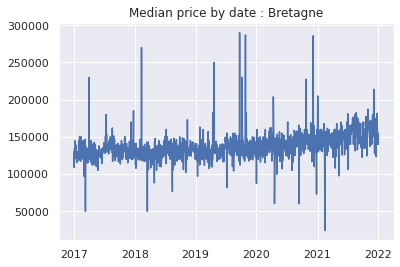

==== Centre-Val de Loire ====


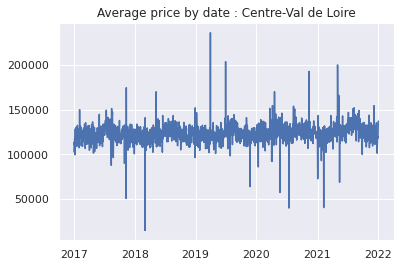

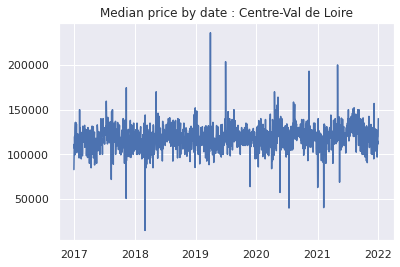

==== Corse ====


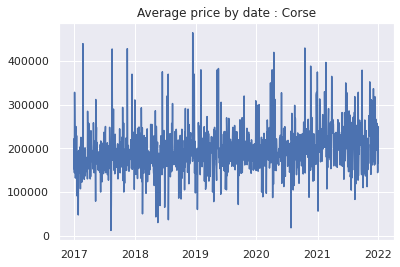

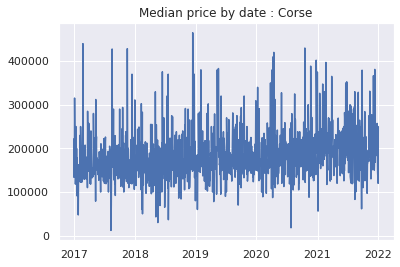

==== Grand Est ====


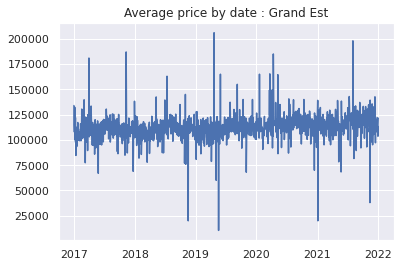

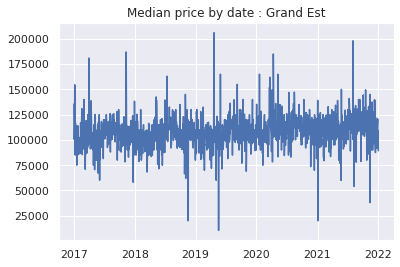

==== Guadeloupe ====


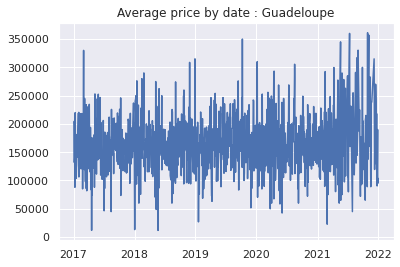

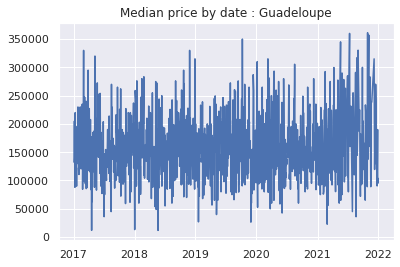

==== Guyane ====


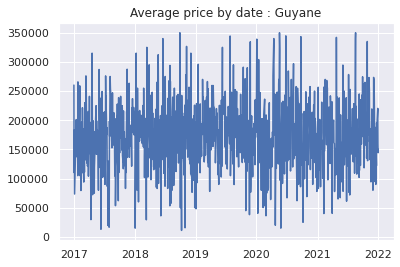

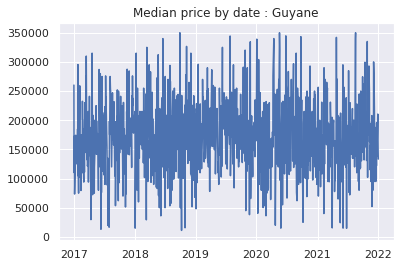

==== Hauts-de-France ====


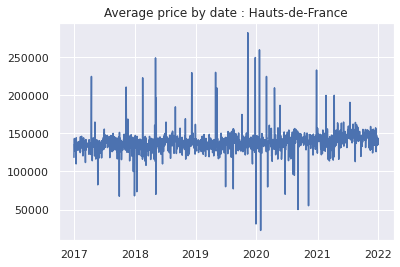

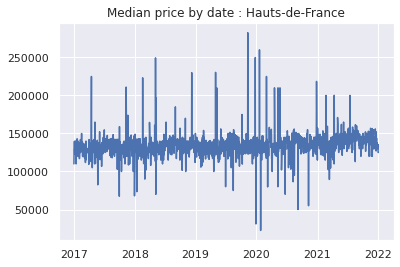

==== La Réunion ====


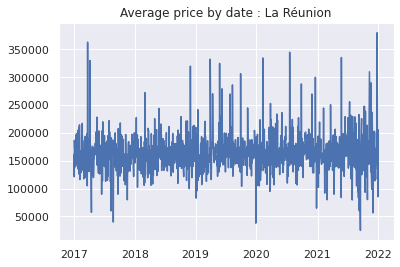

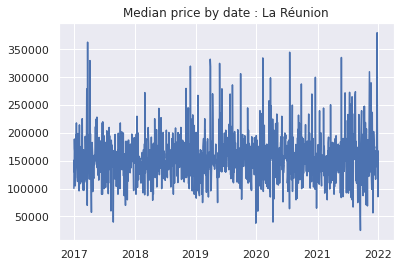

==== Martinique ====


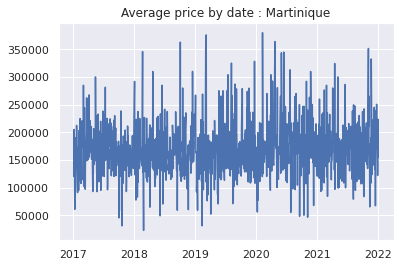

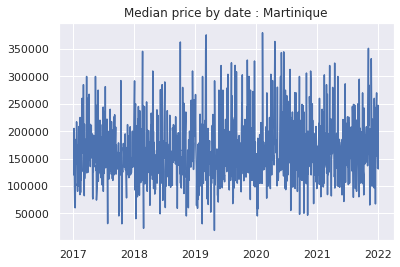

==== Normandie ====


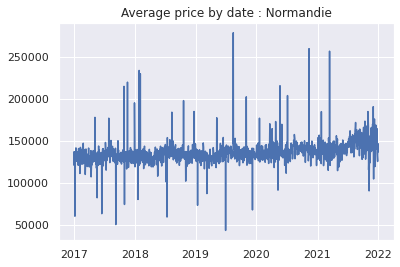

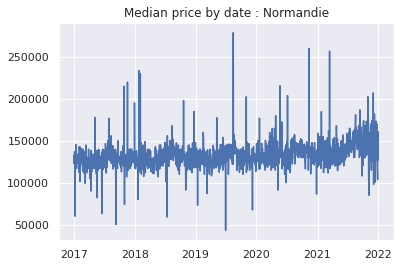

==== Nouvelle-Aquitaine ====


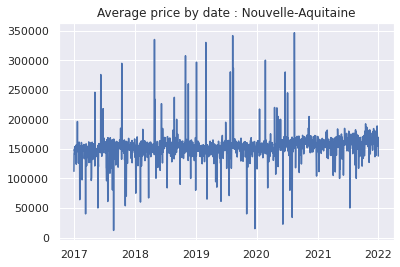

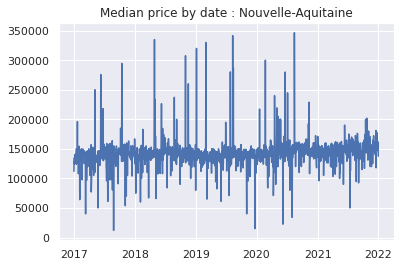

==== Occitanie ====


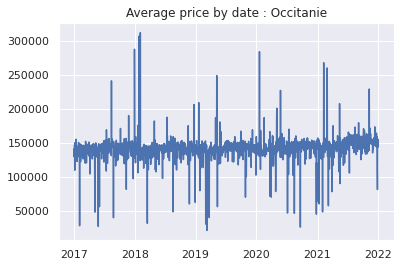

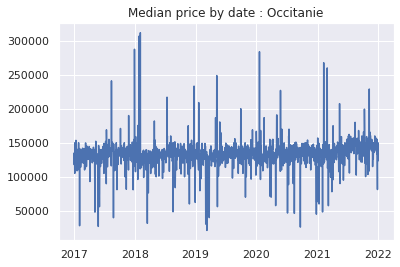

==== Pays de la Loire ====


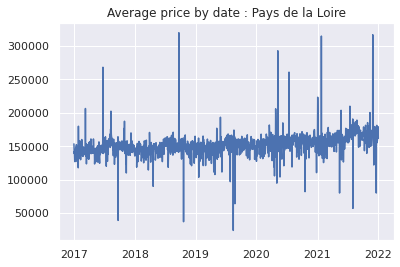

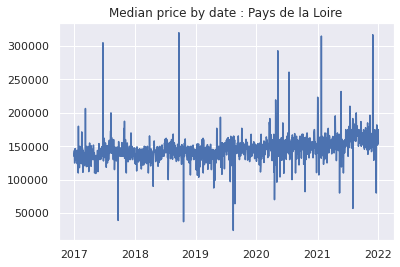

==== Provence-Alpes-Côte d'Azur ====


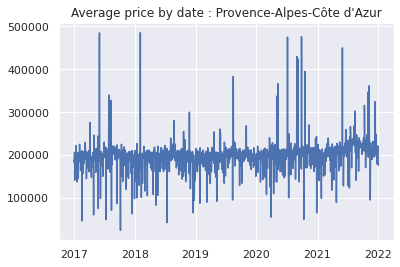

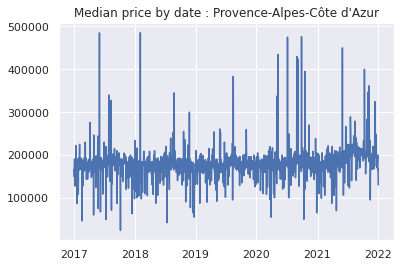

==== Île-de-France ====


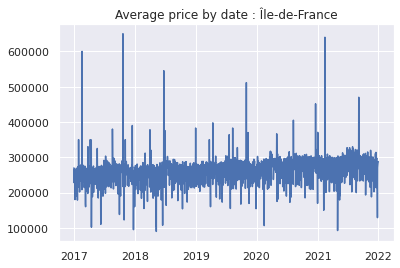

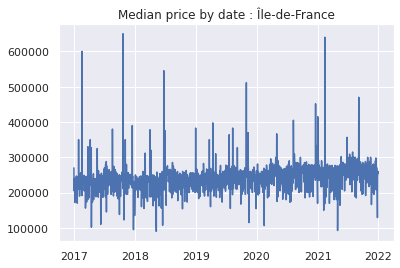

In [21]:
def rep_price_by_region_no_expensive_ones():
    for region, group in dataset.groupby("region"):
        print(f"==== {region} ====")
        # Remove the 10% most expensive entries
        nb_entries = len(group)
        nb_entries_to_keep = int(nb_entries * 0.9)
        group["valeur_fonciere"] = group["valeur_fonciere"].astype(float)
        group_without_expensives = group.nsmallest(n=nb_entries_to_keep, columns="valeur_fonciere")
        display_price_date_repartition(group_without_expensives, region)

rep_price_by_region_no_expensive_ones()

#### En supprimant les 15% des biens les plus chers et 15% des biens les moins chers

==== Auvergne-Rhône-Alpes ====


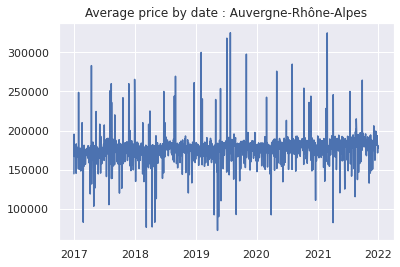

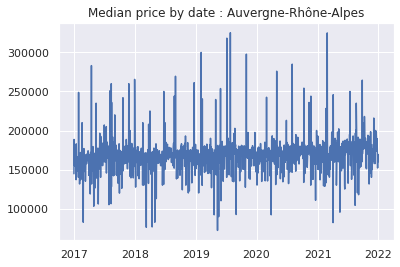

==== Bourgogne-Franche-Comté ====


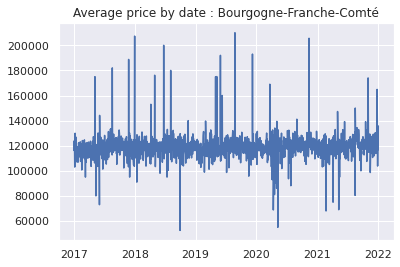

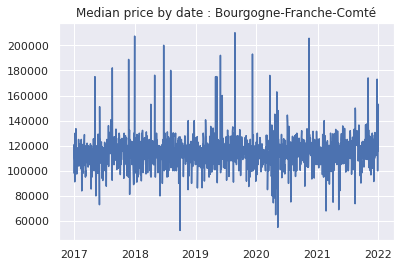

==== Bretagne ====


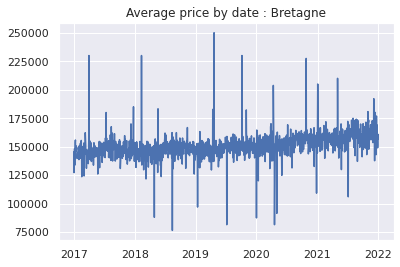

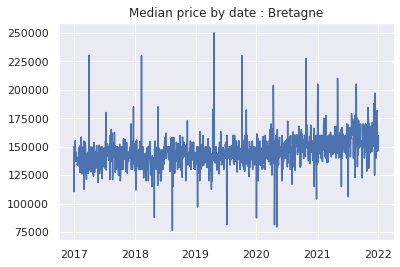

==== Centre-Val de Loire ====


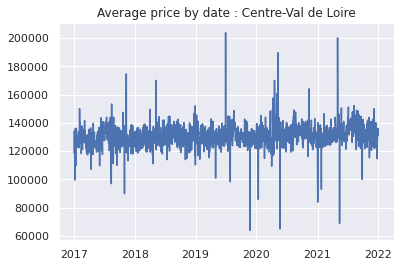

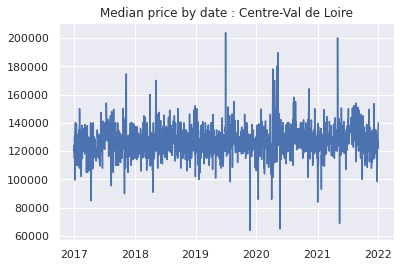

==== Corse ====


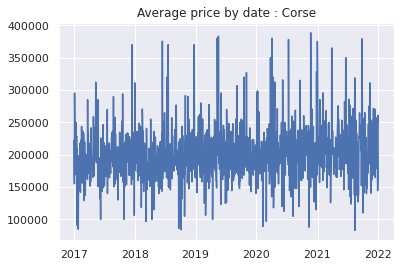

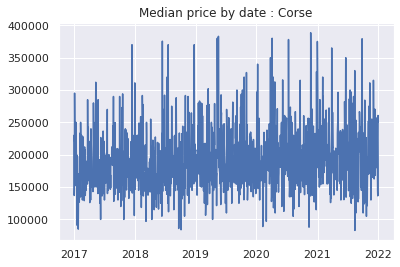

==== Grand Est ====


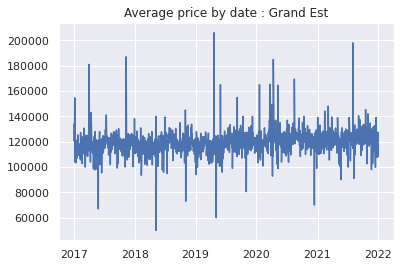

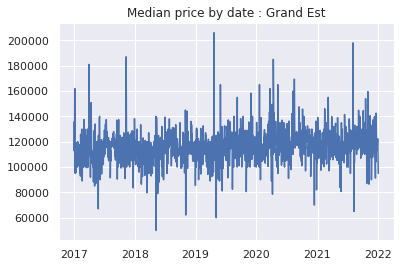

==== Guadeloupe ====


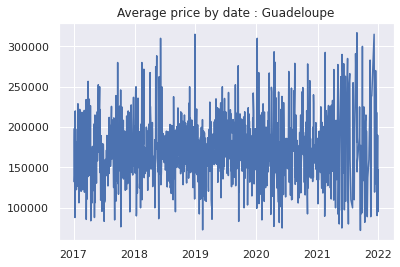

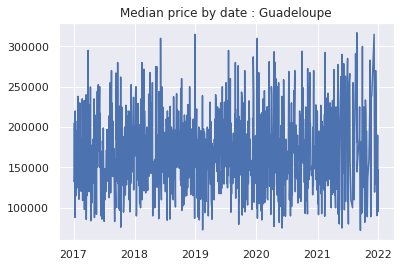

==== Guyane ====


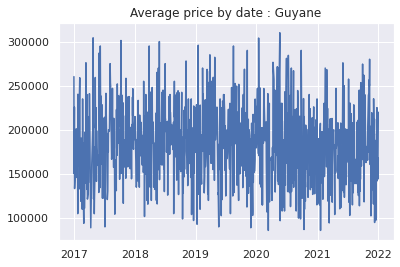

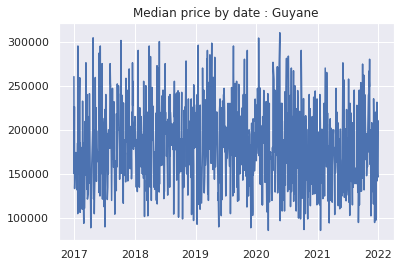

==== Hauts-de-France ====


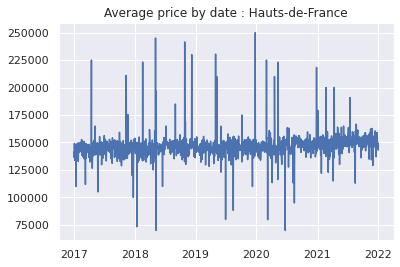

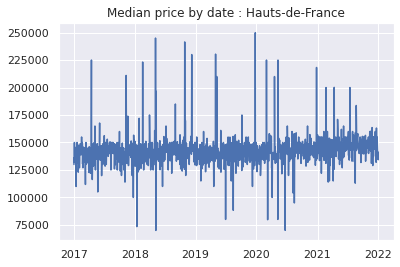

==== La Réunion ====


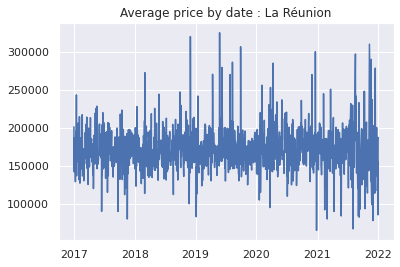

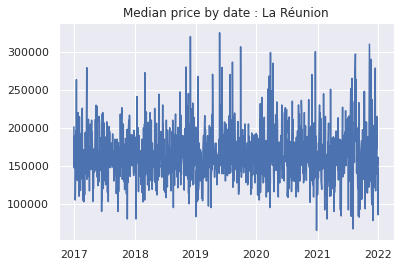

==== Martinique ====


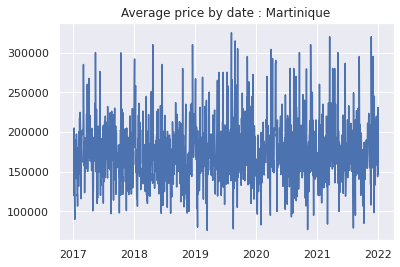

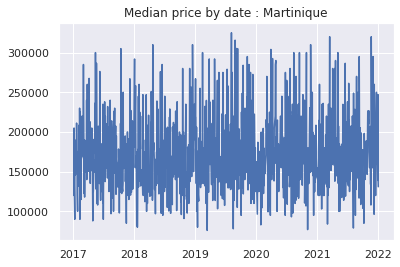

==== Normandie ====


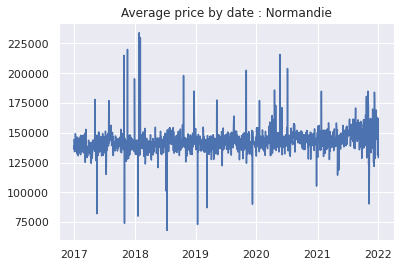

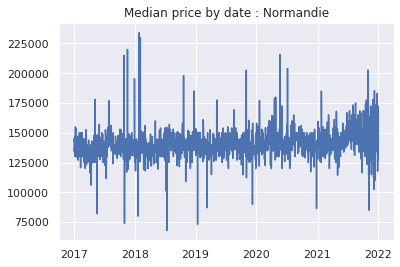

==== Nouvelle-Aquitaine ====


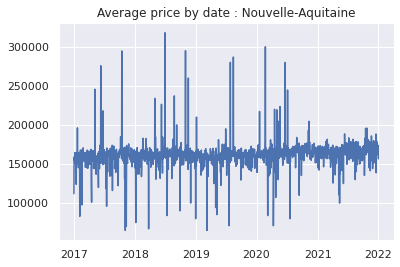

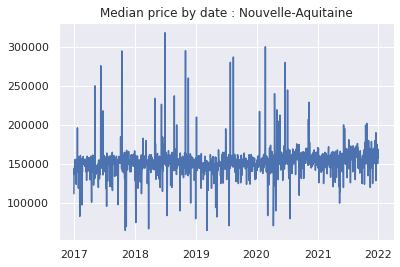

==== Occitanie ====


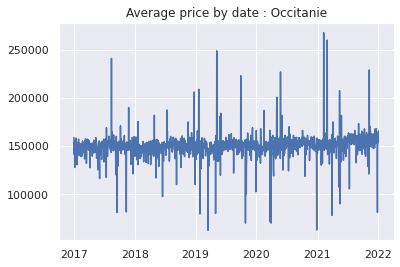

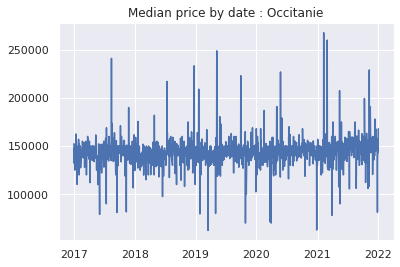

==== Pays de la Loire ====


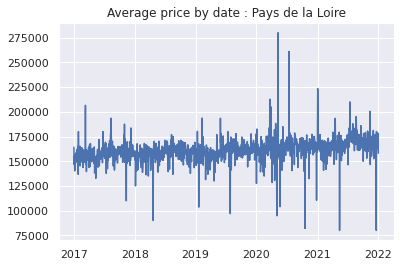

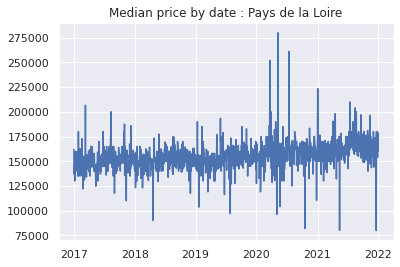

==== Provence-Alpes-Côte d'Azur ====


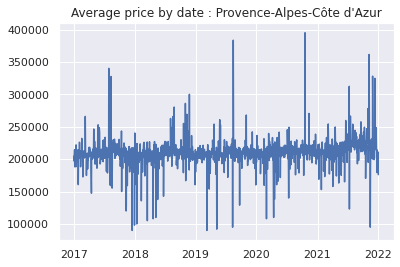

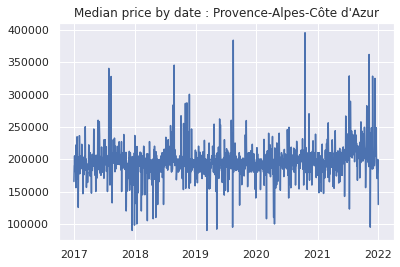

==== Île-de-France ====


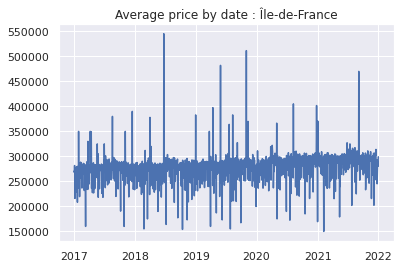

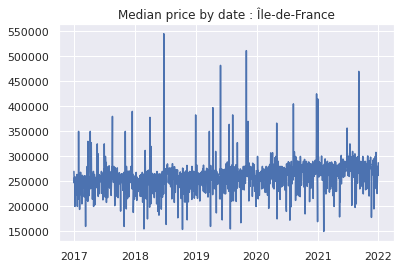

In [22]:
def rep_price_by_region_no_expensive_ones():
    for region, group in dataset.groupby("region"):
        print(f"==== {region} ====")
        nb_entries = len(group)
        group["valeur_fonciere"] = group["valeur_fonciere"].astype(float)
        group_without_expensives = group.nsmallest(int(nb_entries * 0.85), "valeur_fonciere").nlargest(int(nb_entries * 0.85 * 0.85), "valeur_fonciere")
        display_price_date_repartition(group_without_expensives, region)

rep_price_by_region_no_expensive_ones()

### Moyenne par mois

#### Global

In [23]:
def to_datetime(date_str: str) -> dt.datetime:
    return dt.datetime.strptime(date_str, '%Y-%m-%d').date()

def display_price_date_repartition_per_month(dataset: pd.DataFrame, title: str):
    df = dataset.filter(["date_mutation", "valeur_fonciere"], axis=1)
    df["date_mutation"] = df["date_mutation"].apply(to_datetime)
    df["valeur_fonciere"] = df["valeur_fonciere"].astype(float)
    df["mois"] = df["date_mutation"].apply(lambda d: d.month)
    sns.set()
    df.groupby('mois')['valeur_fonciere'].mean().plot(kind='bar', rot=0, linewidth=0)

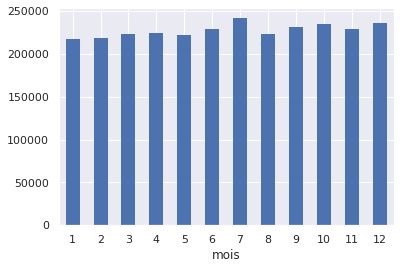

In [24]:
display_price_date_repartition_per_month(dataset, "")

#### Par année

In [25]:
def disp_price_per_year_and_month(df: pd.DataFrame):
    df = df.filter(["date_mutation", "valeur_fonciere"], axis=1)
    df["date_mutation"] = df["date_mutation"].apply(to_datetime)
    df["valeur_fonciere"] = df["valeur_fonciere"].astype(float)
    df["mois"] = df["date_mutation"].apply(lambda d: d.month)
    df["annee"] = df["date_mutation"].apply(lambda d: d.year)
    for year, group in df.groupby("annee"):
        plt.title(f"Average price per month : {year}")
        group.groupby('mois')['valeur_fonciere'].mean().plot(kind='bar', rot=0, linewidth=0)
        plt.show()

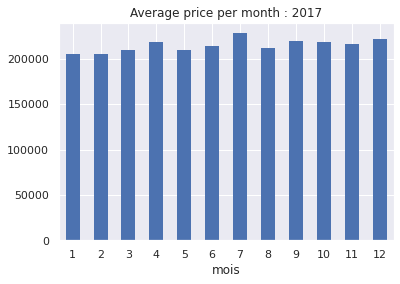

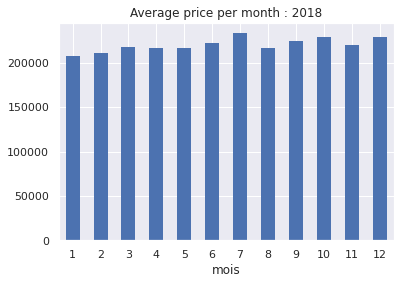

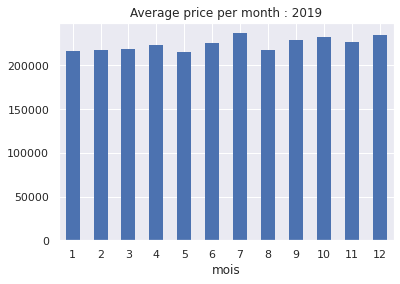

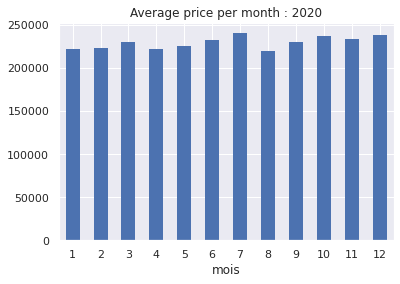

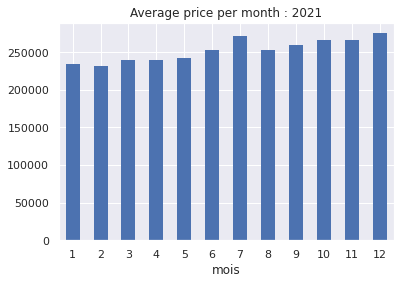

In [26]:
disp_price_per_year_and_month(dataset)

## Corrélation

On cherche à voir quels attributs sont liés, i.e les champs qui sont utiles pour prédire le prix par exemple

In [27]:
# Utile ??
def plot_all_pairs():
    # plots scatter plots for every pair of attributes and histograms along the diagonal
    sns.pairplot(df) 

def display_correlation_heatmap(df: pd.DataFrame, title: str = ""):
    corr_df = df.corr(numeric_only=False)
    num_columns = len(corr_df.columns)
    fig,ax = plt.subplots(figsize=(num_columns, num_columns))
    fig.suptitle("Correlation heatmap")
    headmap_plot = sns.heatmap(corr_df, ax=ax, annot=True, linewidths=0.05, fmt= '.2f',cmap="magma")  
    plt.show()

## Appartement ou Maison

difference of mean,median & mode between house and aparment

number of rooms per type

## Prix par nombre de pièces

## Répartition du prix au m²

## Misc

Choses diverses à tester

### Biens avec beaucoup trop de pièces

On a des biens avec 112 pièces : soit des erreurs, soit des manoirs !

Dans les deux cas, on en veut pas.

Aussi : il faut enlever les maisons qui n'ont aucune pièce (logique)

==== TOUTES LES PIECES ====
count    4.797895e+06
mean     3.513731e+00
std      1.560019e+00
min      0.000000e+00
25%      2.000000e+00
50%      3.000000e+00
75%      4.000000e+00
max      1.120000e+02
Name: nombre_pieces_principales, dtype: float64


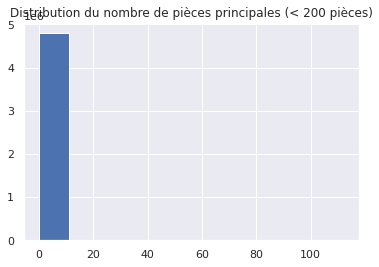

==== < 20 pièces ====
count    4.797533e+06
mean     3.511624e+00
std      1.535667e+00
min      0.000000e+00
25%      2.000000e+00
50%      3.000000e+00
75%      4.000000e+00
max      1.900000e+01
Name: nombre_pieces_principales, dtype: float64


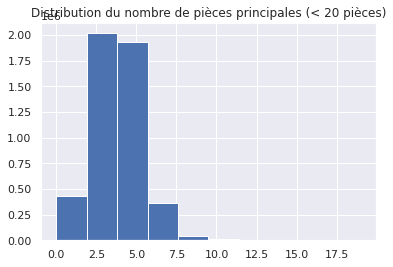

==== < 15 pièces ====
count    4.797053e+06
mean     3.510365e+00
std      1.530527e+00
min      0.000000e+00
25%      2.000000e+00
50%      3.000000e+00
75%      4.000000e+00
max      1.400000e+01
Name: nombre_pieces_principales, dtype: float64


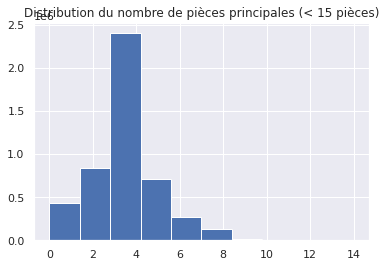

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt

def describe_nb_pieces(max_pieces: int):
    s = dataset[dataset["nombre_pieces_principales"] < max_pieces]["nombre_pieces_principales"].astype(int)
    print(s.describe())

    plt.title(f"Distribution du nombre de pièces principales (< {max_pieces} pièces)")
    s.hist()
    plt.show()


print("==== TOUTES LES PIECES ====")
describe_nb_pieces(200)
print("==== < 20 pièces ====")
describe_nb_pieces(20)
print("==== < 15 pièces ====")
describe_nb_pieces(15)

Bilan : 12 pièces semble être un bon maximum

In [29]:
print("Nb entries without main rooms :", len(dataset[dataset["nombre_pieces_principales"] == 0]))
print("Nb entries with too much main rooms :", len(dataset[dataset["nombre_pieces_principales"] > 12]))

Nb entries without main rooms : 6248
Nb entries with too much main rooms : 1800


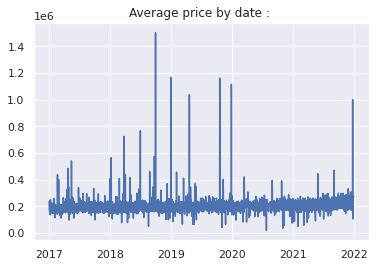

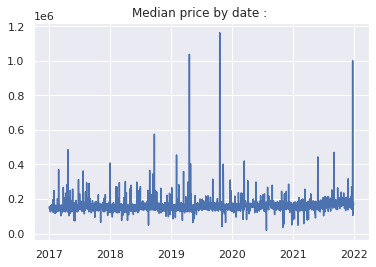

In [30]:
display_price_date_repartition(dataset[(dataset["nombre_pieces_principales"] > 0) & (dataset["nombre_pieces_principales"] <= 12)], "")

Malheureusement, ça n'enlève pas grands sauts de données